In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import math
import seaborn as sns
import scipy.stats as scs

from importlib import reload
%matplotlib inline

import base
import utility

# 1. USD/JPY Pair 2000-2018_Feb

In [2]:
if True:
    # Import USD/JPY hourly data
    data = pd.read_csv('fx_data/USDJPY/USDJPY_2000-201802_hour.csv', header=0)
    data['time'] = pd.to_datetime(data['time'], infer_datetime_format=True)

In [3]:
ta = None
r_periods = [1, 2, 6, 24, 120, 240, 480, 2400]
ta = base.TechnicalAnalysisCase(data)
ta.add_returns(r_periods)

In [4]:
ta.data.describe()

,open,high,low,close,-1P_return,+1P_return,-2P_return,+2P_return,-6P_return,+6P_return,-24P_return,+24P_return,-120P_return,+120P_return,-240P_return,+240P_return,-480P_return,+480P_return,-2400P_return,+2400P_return
count,96779.000000,96779.000000,96779.000000,96779.000000,96778.000000,96778.000000,96777.000000,96777.000000,96773.000000,96773.000000,96755.000000,96755.000000,96659.000000,96659.000000,96539.000000,96539.000000,96299.000000,96299.000000,94379.000000,94379.000000
mean,105.657949,105.756236,105.557918,105.657920,0.000096,0.000096,0.000183,0.000183,0.000499,0.000499,0.001763,0.001763,0.011230,0.011230,0.026330,0.026330,0.053255,0.053255,0.302960,0.302960
std,13.708467,13.717602,13.699986,13.708467,0.141047,0.141047,0.198202,0.198202,0.337196,0.337196,0.670326,0.670326,1.467076,1.467076,2.065359,2.065359,2.943702,2.943702,6.933715,6.933715
min,75.630000,75.750000,75.560000,75.630000,-3.633239,-3.633239,-4.128362,-4.128362,-5.610477,-5.610477,-5.968468,-5.968468,-9.665428,-9.665428,-9.000874,-9.000874,-13.555514,-13.555514,-20.012811,-20.012811
25%,97.366500,97.500500,97.248500,97.369000,-0.060412,-0.060412,-0.086562,-0.086562,-0.161160,-0.161160,-0.370543,-0.370543,-0.884811,-0.884811,-1.297994,-1.297994,-1.809768,-1.809768,-4.189397,-4.189397
50%,108.490000,108.610000,108.384000,108.490000,0.000000,0.000000,0.000000,0.000000,0.001799,0.001799,0.007817,0.007817,0.027506,0.027506,-0.020086,-0.020086,-0.011952,-0.011952,-0.157189,-0.157189
75%,117.190000,117.300000,117.090000,117.190000,0.063473,0.063473,0.090293,0.090293,0.164426,0.164426,0.384999,0.384999,0.929501,0.929501,1.313391,1.313391,1.872675,1.872675,4.139479,4.139479
max,134.900000,135.400000,134.750000,134.900000,3.794790,3.794790,4.707127,4.707127,4.953765,4.953765,6.408458,6.408458,7.699902,7.699902,9.621175,9.621175,12.835803,12.835803,24.331778,24.331778


### Overall Price Movment during the whole period

In [5]:
df = data.iloc[:, :5].set_index('time')
utility.plot_candlestick(df.iloc[:96779])

/home/ryohayama/.local/lib/python3.6/site-packages/pandas/core/indexing.py:357: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
/home/ryohayama/.local/lib/python3.6/site-packages/pandas/core/indexing.py:621: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item_labels[indexer[info_axis]]] = value


Loading BokehJS ...

Overall, USD/JPY traded between 75-135 during this period of ~17 years. It appears there are both upward and downward trends in a medium term (~a few years). 

### Check the distribution of returns for a given period

In this analysis, trailing returns (i.e. returns up to th current timepoint) and the future returns from the current timepoint) were examined. Their distributions were visually examined and checked for normality.

In [6]:
plus_labels = [col for col in ta.data.columns if 'return' in col and '+' in col]
minus_labels = [col for col in ta.data.columns if 'return' in col and '-' in col]
return_labels = minus_labels + plus_labels
print(plus_labels)
print(minus_labels)

['+1P_return', '+2P_return', '+6P_return', '+24P_return', '+120P_return', '+240P_return', '+480P_return', '+2400P_return']
['-1P_return', '-2P_return', '-6P_return', '-24P_return', '-120P_return', '-240P_return', '-480P_return', '-2400P_return']


********** Normality Test **********
  -1P_return:		p-value = 0.000000
  -2P_return:		p-value = 0.000000
  -6P_return:		p-value = 0.000000
 -24P_return:		p-value = 0.000000
-120P_return:		p-value = 0.000000
-240P_return:		p-value = 0.000000
-480P_return:		p-value = 0.000000
-2400P_return:		p-value = 0.000000
  +1P_return:		p-value = 0.000000
  +2P_return:		p-value = 0.000000
  +6P_return:		p-value = 0.000000
 +24P_return:		p-value = 0.000000
+120P_return:		p-value = 0.000000
+240P_return:		p-value = 0.000000
+480P_return:		p-value = 0.000000
+2400P_return:		p-value = 0.000000


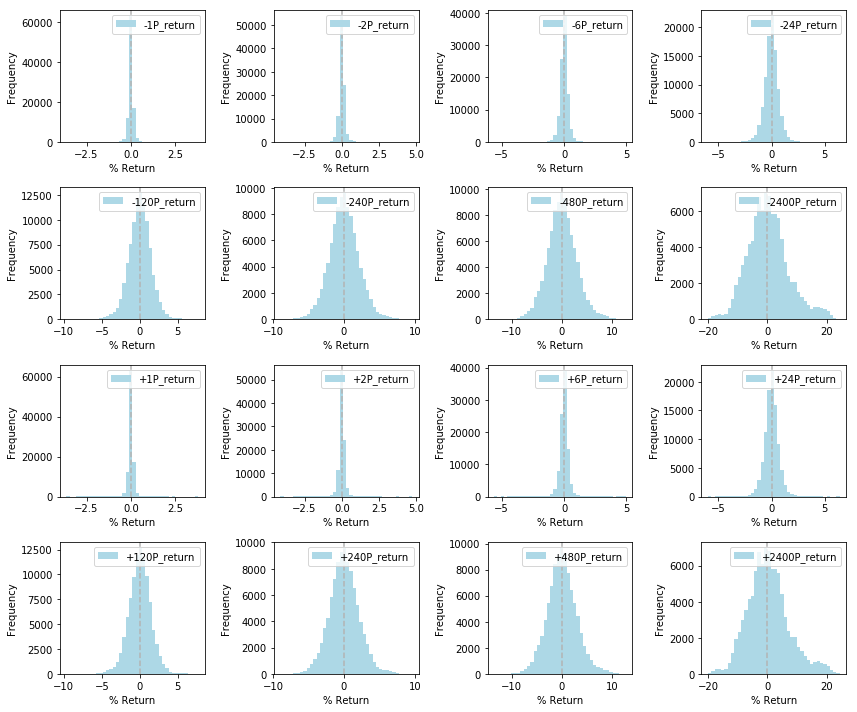

In [7]:
print('*'*10, "Normality Test", '*'*10)
fig = plt.figure(figsize=(12, 10))
for i, label in enumerate(return_labels):
    ax = fig.add_subplot(4, 4, i+1)
    series =  ta.data[label]
    _, pval = scs.normaltest(np.array(series), nan_policy='omit')
    print('%12s:\t\tp-value = %f' % (label, pval))
    ax.axvline(0, ls='--', color='0.7')
    series.plot(kind='hist', bins=40, color='lightblue', ax=ax, label=label)
    ax.set_xlabel('% Return')
    ax.legend()
plt.tight_layout()

So returns are not normally distributed.

********** Test For t-distribution wit df=10 **********
  -1P_return:		p-value = 0.000000
  -2P_return:		p-value = 0.000000
  -6P_return:		p-value = 0.000000
 -24P_return:		p-value = 0.000000
-120P_return:		p-value = 0.000000
-240P_return:		p-value = 0.000000
-480P_return:		p-value = 0.000000
-2400P_return:		p-value = 0.000000
  +1P_return:		p-value = 0.000000
  +2P_return:		p-value = 0.000000
  +6P_return:		p-value = 0.000000
 +24P_return:		p-value = 0.000000
+120P_return:		p-value = 0.000000
+240P_return:		p-value = 0.000000
+480P_return:		p-value = 0.000000
+2400P_return:		p-value = 0.000000


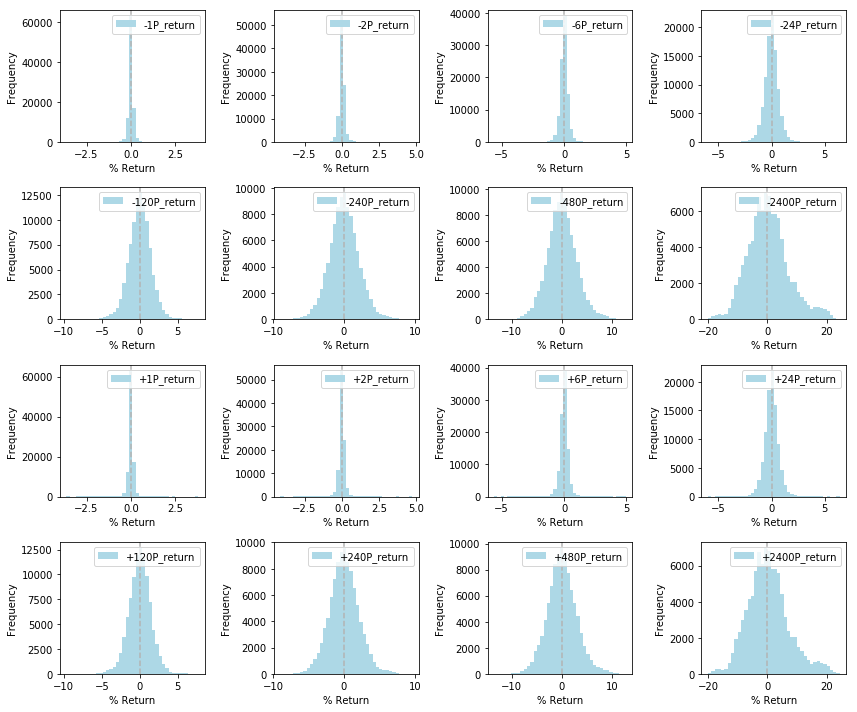

In [8]:
print('*'*10, "Test For t-distribution wit df=10", '*'*10)
fig = plt.figure(figsize=(12, 10))
for i, label in enumerate(return_labels):
    ax = fig.add_subplot(4, 4, i+1)
    series =  ta.data[label].dropna()
    _, pval = scs.kstest(np.array(series), 't', args=(10,))
    print('%12s:\t\tp-value = %f' % (label, pval))
    ax.axvline(0, ls='--', color='0.7')
    series.plot(kind='hist', bins=40, color='lightblue', ax=ax, label=label)
    ax.set_xlabel('% Return')
    ax.legend()
plt.tight_layout()

### Assessing auto-correlation by visualization

Here I'm assessing if there is any correlation between trailing and future returns. This is an informal test for auto-correlation, where whether the past performance for a given period is any predicitive of the future performance for a given period. Auto-correlation should be formally tested with autoregressive models (AR, etc)

Evaluate if trailing returns (returns up to a timepoint) correlate with future returns (return from a timepoint). The former is indicated with '-' sign and the latter with '+' in the DataFrame labels. In this notebook, 1, 2, and 6 hours, as well as 1, 5, 10, 20, and 100 day returns of both kinds were tracked. Trailing returns are scattered against future returns and Pearson's correlations were calculated.

CPU times: user 14.1 s, sys: 7.78 s, total: 21.8 s
Wall time: 11 s


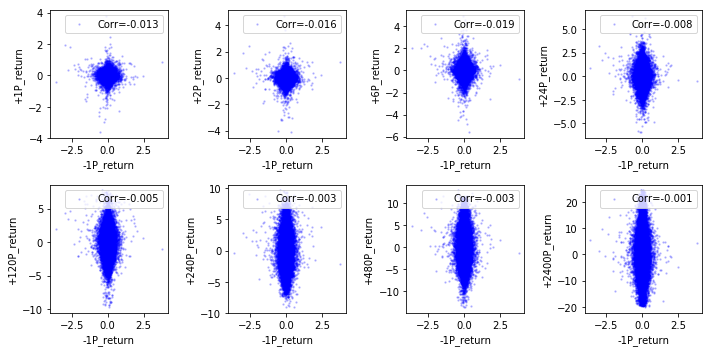

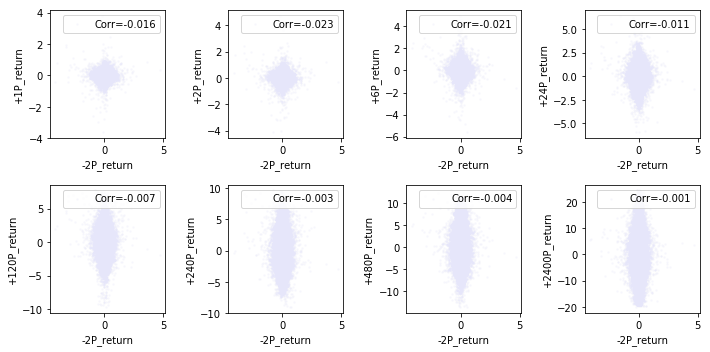

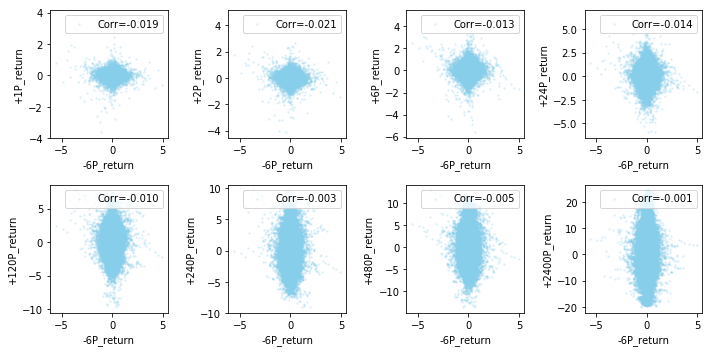

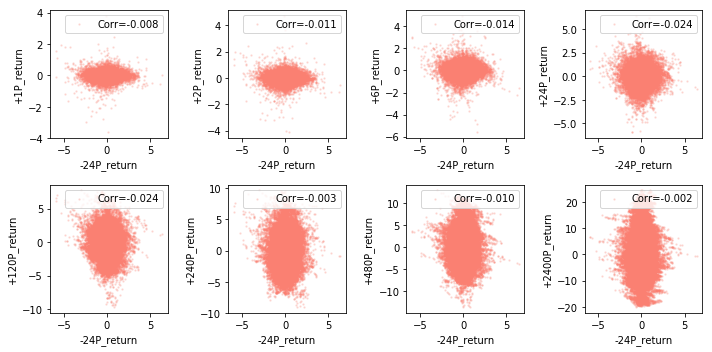

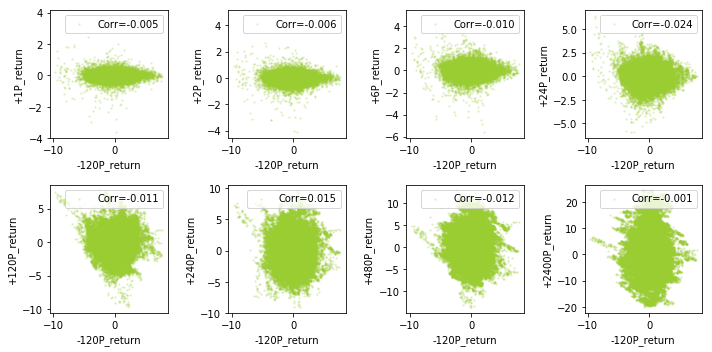

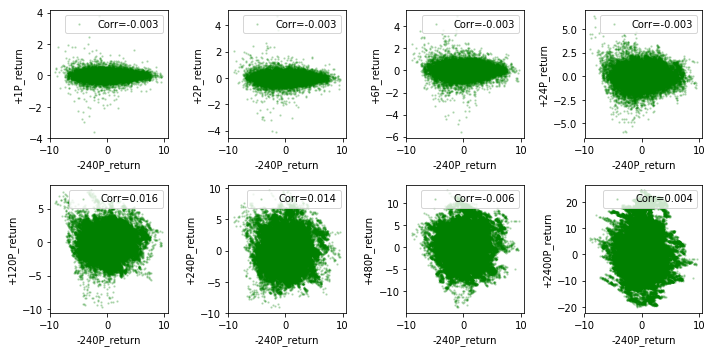

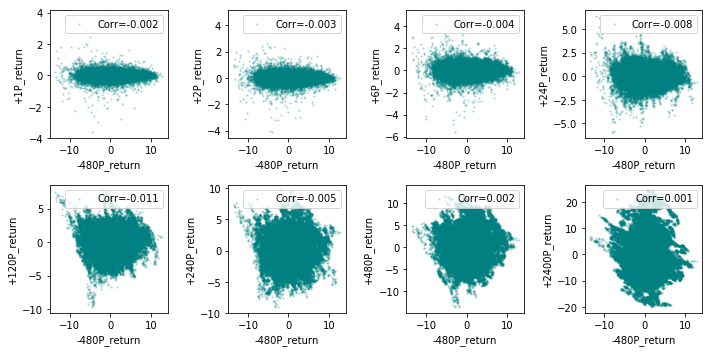

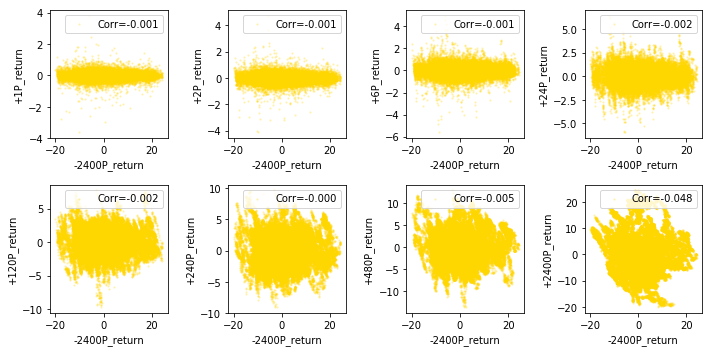

In [9]:
%%time
colors = ['blue', 'lavender', 'skyblue', 'salmon', 'yellowgreen', 'green', 'teal', 'gold']
for i, minus_r in enumerate(minus_labels):
    fig = plt.figure(figsize=(10, 5))
    for j, plus_r in enumerate(plus_labels):
        ax = fig.add_subplot(2, 4, j+1)
        pearson = ta.data[minus_r].corr(ta.data[plus_r])
        ax.scatter(ta.data[minus_r], ta.data[plus_r], color=colors[i], s=2, alpha=0.2, label=('Corr=%.3f' % pearson))
        ax.set_xlabel(minus_r)
        ax.set_ylabel(plus_r)
        ax.legend(loc='upper right')
    plt.tight_layout()

It appears that overall, trends do not persist. So trend up to a point does not correlate with trend from that point for both short and longer periods. 

In [10]:
%%time
### THIS ONE TAKES A LONG TIME TO COMPLETE SO RUN WHEN NECESSARY
if False:
    cmaps = ['Blues', 'Reds', 'Greens', 'Purples', 'Oranges', 'Greys', 'YlOrRd', 'PuBu']
    for i, minus_r in enumerate(minus_labels):
        print('%d-Processing %s...' % (i+1, minus_r))
        fig = plt.figure(figsize=(12, 6))
        for j, plus_r in enumerate(plus_labels):
            print('\t%dProcessing %s...' % (j+1, plus_r))
            ax = fig.add_subplot(2, 4, j+1)
            df = pd.concat([ta.data[minus_r], ta.data[plus_r]], axis=1).dropna()
            sns.kdeplot(df.iloc[:, 0], df.iloc[:, 1], bw='silverman', cmap=cmaps[i], ax=ax)
            ax.set_xlabel(minus_r)
            ax.set_ylabel(plus_r)
            pearson = ta.data[minus_r].corr(ta.data[plus_r])
            ax.set_title('Pearson\'s Correlation=%.3f' % pearson)
        plt.tight_layout()

CPU times: user 7 µs, sys: 4 µs, total: 11 µs
Wall time: 6.2 µs


There appears to be some substructures based on the kde plots, especially for longer term returns. It'd be interesting to see what conditions those different peaks in density correspond to.

# 2. EUR/JPY Pair 2000-2018_Feb

In [11]:
if True:
    # Import USD/JPY hourly data
    data = pd.read_csv('fx_data/EURJPY/EURJPY_2002-201802_hour.csv', header=0)
    data['time'] = pd.to_datetime(data['time'], infer_datetime_format=True)

In [12]:
ta = None
r_periods = [1, 2, 6, 24, 120, 240, 480, 2400]
ta = base.TechnicalAnalysisCase(data)
ta.add_returns(r_periods)

In [13]:
ta.data.describe()

,open,high,low,close,-1P_return,+1P_return,-2P_return,+2P_return,-6P_return,+6P_return,-24P_return,+24P_return,-120P_return,+120P_return,-240P_return,+240P_return,-480P_return,+480P_return,-2400P_return,+2400P_return
count,94995.000000,94995.000000,94995.000000,94995.000000,94994.000000,94994.000000,94993.000000,94993.000000,94989.000000,94989.000000,94971.000000,94971.000000,94875.000000,94875.000000,94755.000000,94755.000000,94515.000000,94515.000000,92595.000000,92595.000000
mean,130.852528,130.986109,130.715290,130.852719,0.000256,0.000256,0.000509,0.000509,0.001512,0.001512,0.006145,0.006145,0.031733,0.031733,0.062244,0.062244,0.127673,0.127673,0.655955,0.655955
std,15.842361,15.844580,15.844882,15.842360,0.159702,0.159702,0.224868,0.224868,0.384568,0.384568,0.765679,0.765679,1.658665,1.658665,2.311775,2.311775,3.284183,3.284183,7.713459,7.713459
min,94.184000,94.271000,67.250000,94.182000,-5.064872,-5.064872,-5.677166,-5.677166,-8.550253,-8.550253,-8.734347,-8.734347,-17.037037,-17.037037,-17.718533,-17.718533,-25.362603,-25.362603,-30.854711,-30.854711
25%,120.429500,120.606500,120.230000,120.428000,-0.063730,-0.063730,-0.090852,-0.090852,-0.169047,-0.169047,-0.375575,-0.375575,-0.876111,-0.876111,-1.227414,-1.227414,-1.679372,-1.679372,-3.083695,-3.083695
50%,132.008000,132.130000,131.878000,132.006000,0.000000,0.000000,0.003258,0.003258,0.008138,0.008138,0.036208,0.036208,0.116174,0.116174,0.192430,0.192430,0.305129,0.305129,1.584728,1.584728
75%,138.500000,138.605500,138.390000,138.500000,0.067010,0.067010,0.095625,0.095625,0.179324,0.179324,0.416249,0.416249,1.004298,1.004298,1.451331,1.451331,2.063085,2.063085,5.238130,5.238130
max,169.820000,170.000000,169.720000,169.810000,3.277005,3.277005,4.022272,4.022272,5.782569,5.782569,9.176369,9.176369,11.414566,11.414566,12.254902,12.254902,11.700687,11.700687,26.883356,26.883356


### Overall Price Movment during the whole period

In [14]:
df = data.iloc[:, :5].set_index('time')
utility.plot_candlestick(df.iloc[:94995])

/home/ryohayama/.local/lib/python3.6/site-packages/pandas/core/indexing.py:357: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
/home/ryohayama/.local/lib/python3.6/site-packages/pandas/core/indexing.py:621: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item_labels[indexer[info_axis]]] = value


Loading BokehJS ...

Overall, EUR/JPY traded between 98-168 during this period of ~15 years. It appears there are both upward and downward trends in a medium term (~a few years). The fall during Lehman shock is evident in late 2008.<br>
*Thre are some periods where data are missing or abberant, which has to be appropriately treated.

### Check the distribution of returns for a given period

In this analysis, trailing returns (i.e. returns up to th current timepoint) and the future returns from the current timepoint) were examined. Their distributions were visually examined and checked for normality.

In [15]:
plus_labels = [col for col in ta.data.columns if 'return' in col and '+' in col]
minus_labels = [col for col in ta.data.columns if 'return' in col and '-' in col]
return_labels = minus_labels + plus_labels
print(plus_labels)
print(minus_labels)

['+1P_return', '+2P_return', '+6P_return', '+24P_return', '+120P_return', '+240P_return', '+480P_return', '+2400P_return']
['-1P_return', '-2P_return', '-6P_return', '-24P_return', '-120P_return', '-240P_return', '-480P_return', '-2400P_return']


********** Normality Test **********
  -1P_return:		p-value = 0.000000
  -2P_return:		p-value = 0.000000
  -6P_return:		p-value = 0.000000
 -24P_return:		p-value = 0.000000
-120P_return:		p-value = 0.000000
-240P_return:		p-value = 0.000000
-480P_return:		p-value = 0.000000
-2400P_return:		p-value = 0.000000
  +1P_return:		p-value = 0.000000
  +2P_return:		p-value = 0.000000
  +6P_return:		p-value = 0.000000
 +24P_return:		p-value = 0.000000
+120P_return:		p-value = 0.000000
+240P_return:		p-value = 0.000000
+480P_return:		p-value = 0.000000
+2400P_return:		p-value = 0.000000


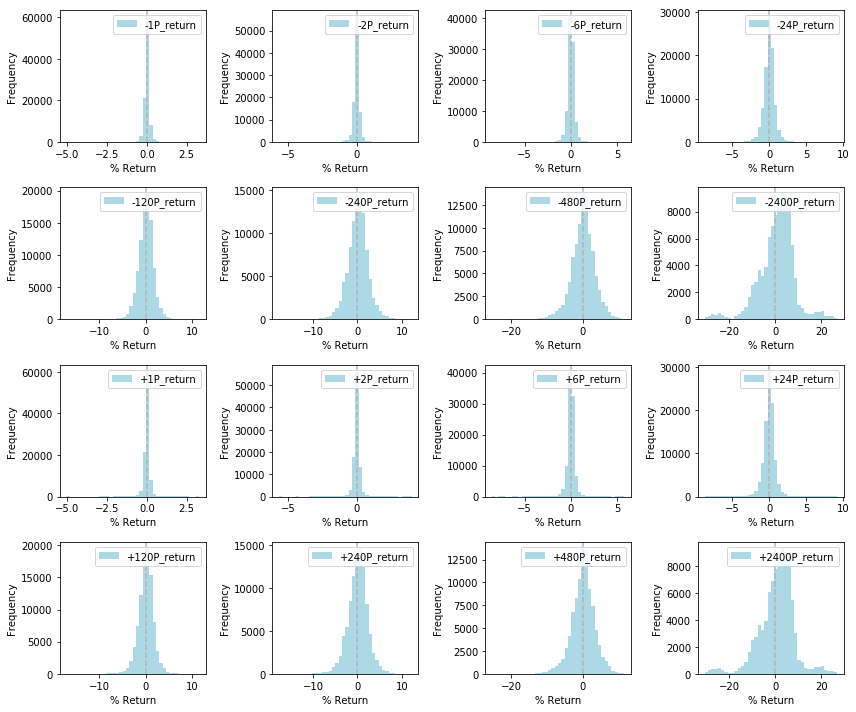

In [16]:
print('*'*10, "Normality Test", '*'*10)
fig = plt.figure(figsize=(12, 10))
for i, label in enumerate(return_labels):
    ax = fig.add_subplot(4, 4, i+1)
    series =  ta.data[label]
    _, pval = scs.normaltest(np.array(series), nan_policy='omit')
    print('%12s:\t\tp-value = %f' % (label, pval))
    ax.axvline(0, ls='--', color='0.7')
    series.plot(kind='hist', bins=40, color='lightblue', ax=ax, label=label)
    ax.set_xlabel('% Return')
    ax.legend()
plt.tight_layout()

So returns are not normally distributed. It appears that longer term returns are slightly more on the positive side, suggesting Euro has been gaining more than Yen during these periods.

********** Test For t-distribution wit df=10 **********
  -1P_return:		p-value = 0.000000
  -2P_return:		p-value = 0.000000
  -6P_return:		p-value = 0.000000
 -24P_return:		p-value = 0.000000
-120P_return:		p-value = 0.000000
-240P_return:		p-value = 0.000000
-480P_return:		p-value = 0.000000
-2400P_return:		p-value = 0.000000
  +1P_return:		p-value = 0.000000
  +2P_return:		p-value = 0.000000
  +6P_return:		p-value = 0.000000
 +24P_return:		p-value = 0.000000
+120P_return:		p-value = 0.000000
+240P_return:		p-value = 0.000000
+480P_return:		p-value = 0.000000
+2400P_return:		p-value = 0.000000


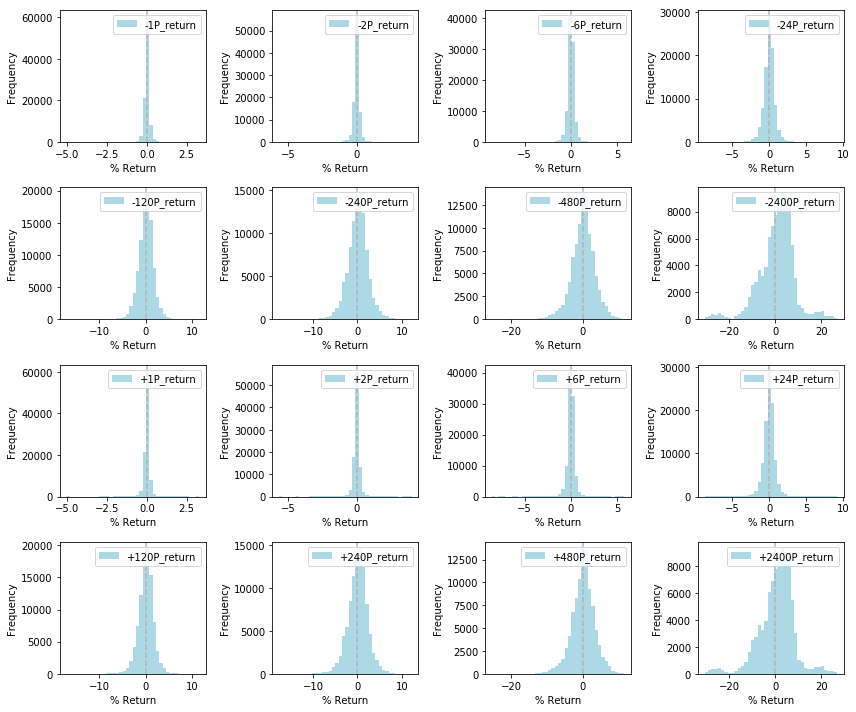

In [17]:
print('*'*10, "Test For t-distribution wit df=10", '*'*10)
fig = plt.figure(figsize=(12, 10))
for i, label in enumerate(return_labels):
    ax = fig.add_subplot(4, 4, i+1)
    series =  ta.data[label].dropna()
    _, pval = scs.kstest(np.array(series), 't', args=(10,))
    print('%12s:\t\tp-value = %f' % (label, pval))
    ax.axvline(0, ls='--', color='0.7')
    series.plot(kind='hist', bins=40, color='lightblue', ax=ax, label=label)
    ax.set_xlabel('% Return')
    ax.legend()
plt.tight_layout()

### Assessing auto-correlation by visualization

Here I'm assessing if there is any correlation between trailing and future returns. This is an informal test for auto-correlation, where whether the past performance for a given period is any predicitive of the future performance for a given period. Auto-correlation should be formally tested with autoregressive models (AR, etc)

Evaluate if trailing returns (returns up to a timepoint) correlate with future returns (return from a timepoint). The former is indicated with '-' sign and the latter with '+' in the DataFrame labels. In this notebook, 1, 2, and 6 hours, as well as 1, 5, 10, 20, and 100 day returns of both kinds were tracked. Trailing returns are scattered against future returns and Pearson's correlations were calculated.

CPU times: user 13.7 s, sys: 7.62 s, total: 21.3 s
Wall time: 10.7 s


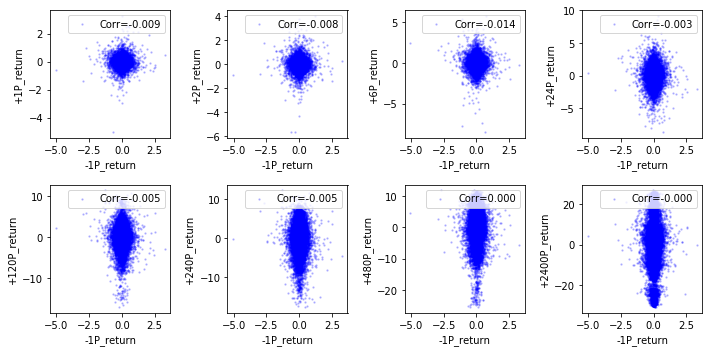

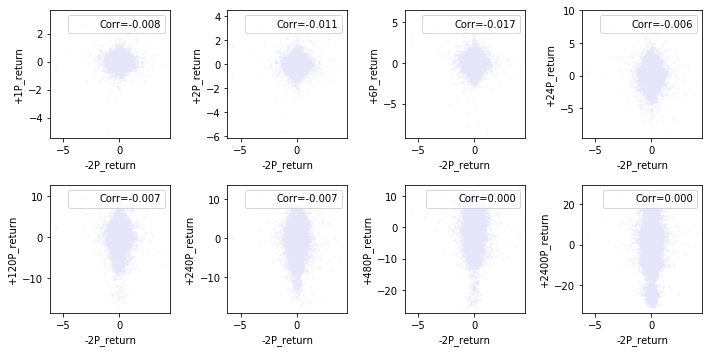

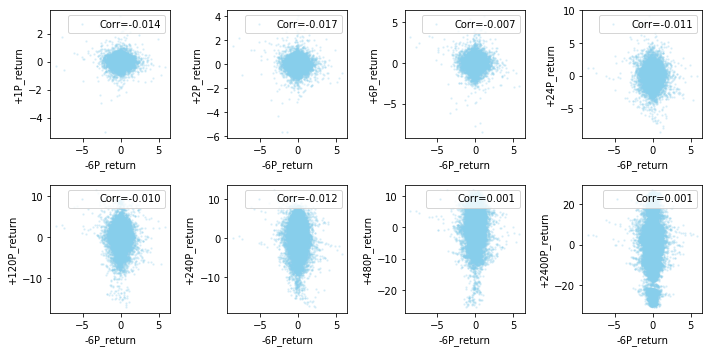

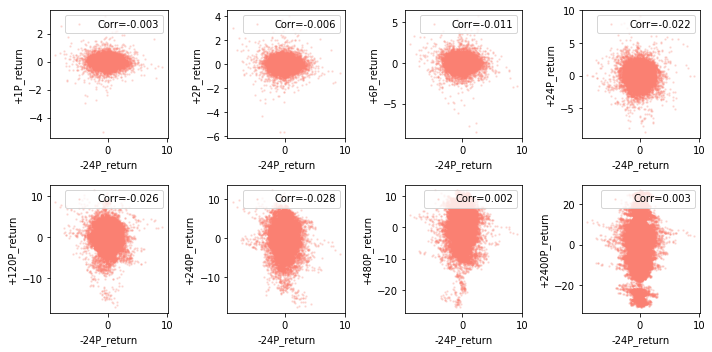

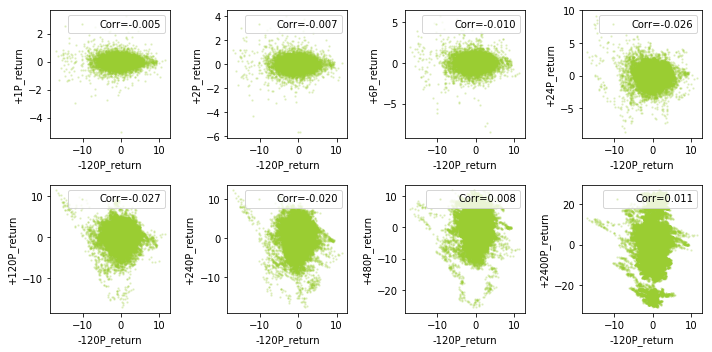

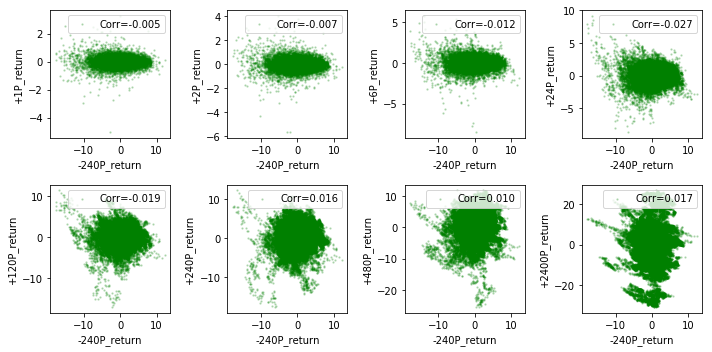

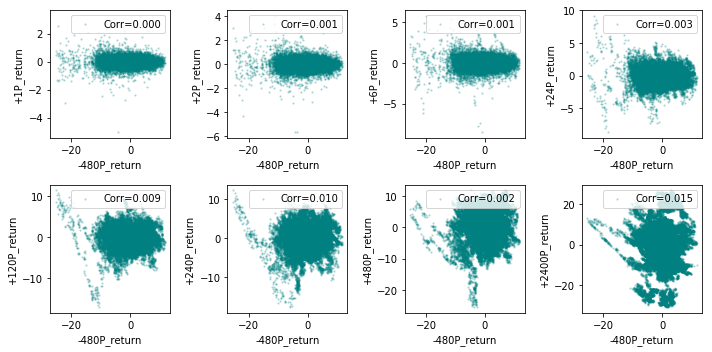

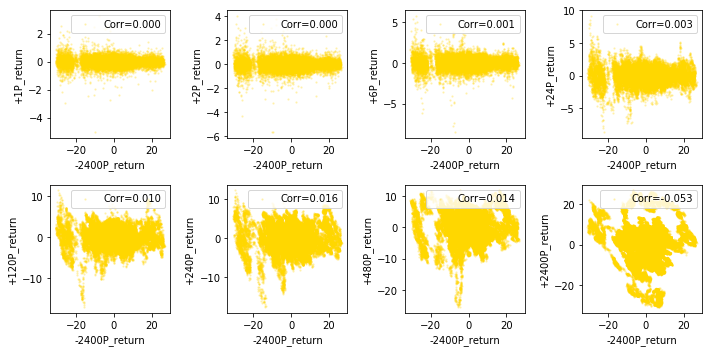

In [18]:
%%time
colors = ['blue', 'lavender', 'skyblue', 'salmon', 'yellowgreen', 'green', 'teal', 'gold']
for i, minus_r in enumerate(minus_labels):
    fig = plt.figure(figsize=(10, 5))
    for j, plus_r in enumerate(plus_labels):
        ax = fig.add_subplot(2, 4, j+1)
        pearson = ta.data[minus_r].corr(ta.data[plus_r])
        ax.scatter(ta.data[minus_r], ta.data[plus_r], color=colors[i], s=2, alpha=0.2, label=('Corr=%.3f' % pearson))
        ax.set_xlabel(minus_r)
        ax.set_ylabel(plus_r)
        ax.legend(loc='upper right')
    plt.tight_layout()

This currency pair is quite different than the USD-JPY pair in a sense that there appear to be more substurctures in those scatter plots than USD-JPY, where the correlation appeared less strong.

In [19]:
%%time
### THIS ONE TAKES A LONG TIME TO COMPLETE SO RUN WHEN NECESSARY
if False:
    cmaps = ['Blues', 'Reds', 'Greens', 'Purples', 'Oranges', 'Greys', 'YlOrRd', 'PuBu']
    for i, minus_r in enumerate(minus_labels):
        print('%d-Processing %s...' % (i+1, minus_r))
        fig = plt.figure(figsize=(12, 6))
        for j, plus_r in enumerate(plus_labels):
            print('\t%dProcessing %s...' % (j+1, plus_r))
            ax = fig.add_subplot(2, 4, j+1)
            df = pd.concat([ta.data[minus_r], ta.data[plus_r]], axis=1).dropna()
            sns.kdeplot(df.iloc[:, 0], df.iloc[:, 1], bw='silverman', cmap=cmaps[i], ax=ax)
            ax.set_xlabel(minus_r)
            ax.set_ylabel(plus_r)
            pearson = ta.data[minus_r].corr(ta.data[plus_r])
            ax.set_title('Pearson\'s Correlation=%.3f' % pearson)
        plt.tight_layout()

CPU times: user 6 µs, sys: 3 µs, total: 9 µs
Wall time: 5.72 µs


# 3. EUR/USD Pair 2000-2018_Feb

In [20]:
if True:
    # Import USD/JPY hourly data
    data = pd.read_csv('fx_data/EURUSD/EURUSD_2000-201802_hour.csv', header=0)
    data['time'] = pd.to_datetime(data['time'], infer_datetime_format=True)

In [21]:
ta = None
r_periods = [1, 2, 6, 24, 120, 240, 480, 2400]
ta = base.TechnicalAnalysisCase(data)
ta.add_returns(r_periods)

In [22]:
ta.data.describe()

,open,high,low,close,-1P_return,+1P_return,-2P_return,+2P_return,-6P_return,+6P_return,-24P_return,+24P_return,-120P_return,+120P_return,-240P_return,+240P_return,-480P_return,+480P_return,-2400P_return,+2400P_return
count,97581.000000,97581.000000,97581.000000,97581.000000,97580.000000,97580.000000,97579.000000,97579.000000,97575.000000,97575.000000,97557.000000,97557.000000,97461.000000,97461.000000,97341.000000,97341.000000,97101.000000,97101.000000,95181.000000,95181.000000
mean,1.237538,1.258780,1.236430,1.237541,0.000368,0.000368,0.000736,0.000736,0.002207,0.002207,0.008797,0.008797,0.042353,0.042353,0.086860,0.086860,0.177425,0.177425,0.970675,0.970675
std,0.158671,6.288463,0.158614,0.158669,0.135077,0.135077,0.191464,0.191464,0.331225,0.331225,0.667095,0.667095,1.474595,1.474595,2.106271,2.106271,3.040380,3.040380,6.676170,6.676170
min,0.823600,0.825600,-0.000100,0.823600,-1.752118,-1.752118,-2.327171,-2.327171,-3.554581,-3.554581,-4.990468,-4.990468,-8.185792,-8.185792,-9.328195,-9.328195,-14.812015,-14.812015,-20.881494,-20.881494
25%,1.126800,1.127790,1.125950,1.126830,-0.056800,-0.056800,-0.081693,-0.081693,-0.153719,-0.153719,-0.372642,-0.372642,-0.861214,-0.861214,-1.242576,-1.242576,-1.696907,-1.696907,-3.328877,-3.328877
50%,1.264400,1.265700,1.263200,1.264440,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.014122,0.014122,0.051066,0.051066,0.084329,0.084329,0.089606,0.089606,1.437301,1.437301
75%,1.347900,1.349000,1.346600,1.347900,0.057507,0.057507,0.082361,0.082361,0.156309,0.156309,0.389175,0.389175,0.977865,0.977865,1.417750,1.417750,2.007339,2.007339,5.731372,5.731372
max,1.601600,1965.000100,1.599200,1.601200,3.168729,3.168729,3.419893,3.419893,3.732558,3.732558,5.324675,5.324675,11.959753,11.959753,15.973154,15.973154,16.821761,16.821761,20.145264,20.145264


There is an obviously wrong quote (high=1965), which is assumed to be a mistake for 1.965

In [34]:
ta.data.loc[4312, 'high'] = 1.965
ta.data.describe()

,open,high,low,close,-1P_return,+1P_return,-2P_return,+2P_return,-6P_return,+6P_return,-24P_return,+24P_return,-120P_return,+120P_return,-240P_return,+240P_return,-480P_return,+480P_return,-2400P_return,+2400P_return
count,97581.000000,97581.000000,97581.000000,97581.000000,97580.000000,97580.000000,97579.000000,97579.000000,97575.000000,97575.000000,97557.000000,97557.000000,97461.000000,97461.000000,97341.000000,97341.000000,97101.000000,97101.000000,95181.000000,95181.000000
mean,1.237538,1.238663,1.236430,1.237541,0.000368,0.000368,0.000736,0.000736,0.002207,0.002207,0.008797,0.008797,0.042353,0.042353,0.086860,0.086860,0.177425,0.177425,0.970675,0.970675
std,0.158671,0.158776,0.158614,0.158669,0.135077,0.135077,0.191464,0.191464,0.331225,0.331225,0.667095,0.667095,1.474595,1.474595,2.106271,2.106271,3.040380,3.040380,6.676170,6.676170
min,0.823600,0.825600,-0.000100,0.823600,-1.752118,-1.752118,-2.327171,-2.327171,-3.554581,-3.554581,-4.990468,-4.990468,-8.185792,-8.185792,-9.328195,-9.328195,-14.812015,-14.812015,-20.881494,-20.881494
25%,1.126800,1.127790,1.125950,1.126830,-0.056800,-0.056800,-0.081693,-0.081693,-0.153719,-0.153719,-0.372642,-0.372642,-0.861214,-0.861214,-1.242576,-1.242576,-1.696907,-1.696907,-3.328877,-3.328877
50%,1.264400,1.265700,1.263200,1.264440,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.014122,0.014122,0.051066,0.051066,0.084329,0.084329,0.089606,0.089606,1.437301,1.437301
75%,1.347900,1.349000,1.346600,1.347900,0.057507,0.057507,0.082361,0.082361,0.156309,0.156309,0.389175,0.389175,0.977865,0.977865,1.417750,1.417750,2.007339,2.007339,5.731372,5.731372
max,1.601600,1.965000,1.599200,1.601200,3.168729,3.168729,3.419893,3.419893,3.732558,3.732558,5.324675,5.324675,11.959753,11.959753,15.973154,15.973154,16.821761,16.821761,20.145264,20.145264


### Overall Price Movment during the whole period

In [35]:
df = data.iloc[:, :5].set_index('time')
utility.plot_candlestick(df.iloc[:97581])

/home/ryohayama/.local/lib/python3.6/site-packages/pandas/core/indexing.py:357: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
/home/ryohayama/.local/lib/python3.6/site-packages/pandas/core/indexing.py:621: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item_labels[indexer[info_axis]]] = value


Loading BokehJS ...

Overall, USD/JPY traded between 0.8-1.6 during this period of ~17 years. It appears there are both upward and downward trends in a medium term (~a few years). 

### Check the distribution of returns for a given period

In this analysis, trailing returns (i.e. returns up to th current timepoint) and the future returns from the current timepoint) were examined. Their distributions were visually examined and checked for normality.

In [36]:
plus_labels = [col for col in ta.data.columns if 'return' in col and '+' in col]
minus_labels = [col for col in ta.data.columns if 'return' in col and '-' in col]
return_labels = minus_labels + plus_labels
print(plus_labels)
print(minus_labels)

['+1P_return', '+2P_return', '+6P_return', '+24P_return', '+120P_return', '+240P_return', '+480P_return', '+2400P_return']
['-1P_return', '-2P_return', '-6P_return', '-24P_return', '-120P_return', '-240P_return', '-480P_return', '-2400P_return']


********** Normality Test **********
  -1P_return:		p-value = 0.000000
  -2P_return:		p-value = 0.000000
  -6P_return:		p-value = 0.000000
 -24P_return:		p-value = 0.000000
-120P_return:		p-value = 0.000000
-240P_return:		p-value = 0.000000
-480P_return:		p-value = 0.000000
-2400P_return:		p-value = 0.000000
  +1P_return:		p-value = 0.000000
  +2P_return:		p-value = 0.000000
  +6P_return:		p-value = 0.000000
 +24P_return:		p-value = 0.000000
+120P_return:		p-value = 0.000000
+240P_return:		p-value = 0.000000
+480P_return:		p-value = 0.000000
+2400P_return:		p-value = 0.000000


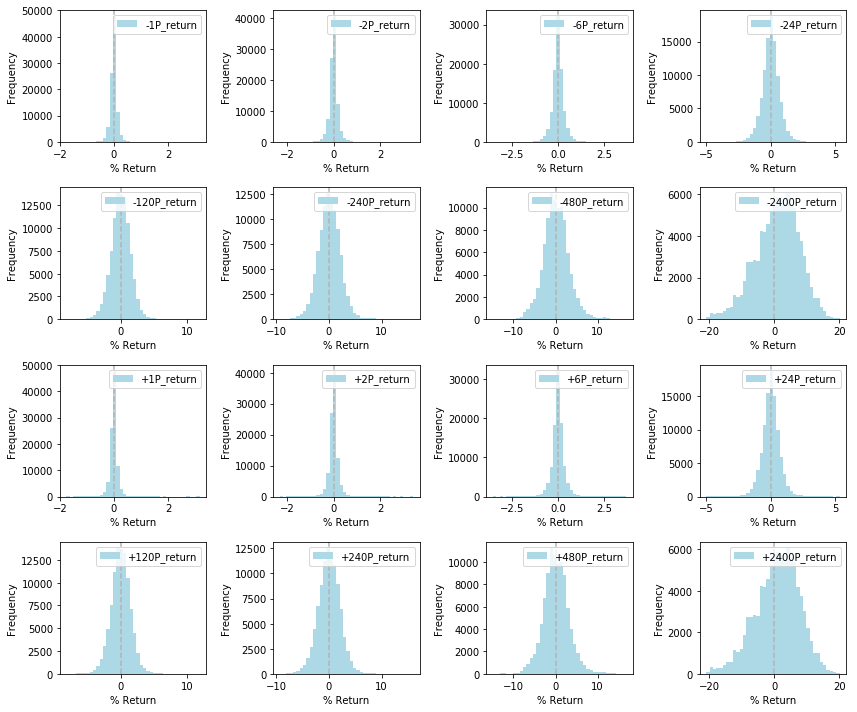

In [37]:
print('*'*10, "Normality Test", '*'*10)
fig = plt.figure(figsize=(12, 10))
for i, label in enumerate(return_labels):
    ax = fig.add_subplot(4, 4, i+1)
    series =  ta.data[label]
    _, pval = scs.normaltest(np.array(series), nan_policy='omit')
    print('%12s:\t\tp-value = %f' % (label, pval))
    ax.axvline(0, ls='--', color='0.7')
    series.plot(kind='hist', bins=40, color='lightblue', ax=ax, label=label)
    ax.set_xlabel('% Return')
    ax.legend()
plt.tight_layout()

So returns are not normally distributed. It appears that longer term returns are slightly more on the positive side, suggesting Euro has been gaining more than USD during these periods. This is understandable based on the analyses of the two pairs above

********** Test For t-distribution wit df=10 **********
  -1P_return:		p-value = 0.000000
  -2P_return:		p-value = 0.000000
  -6P_return:		p-value = 0.000000
 -24P_return:		p-value = 0.000000
-120P_return:		p-value = 0.000000
-240P_return:		p-value = 0.000000
-480P_return:		p-value = 0.000000
-2400P_return:		p-value = 0.000000
  +1P_return:		p-value = 0.000000
  +2P_return:		p-value = 0.000000
  +6P_return:		p-value = 0.000000
 +24P_return:		p-value = 0.000000
+120P_return:		p-value = 0.000000
+240P_return:		p-value = 0.000000
+480P_return:		p-value = 0.000000
+2400P_return:		p-value = 0.000000


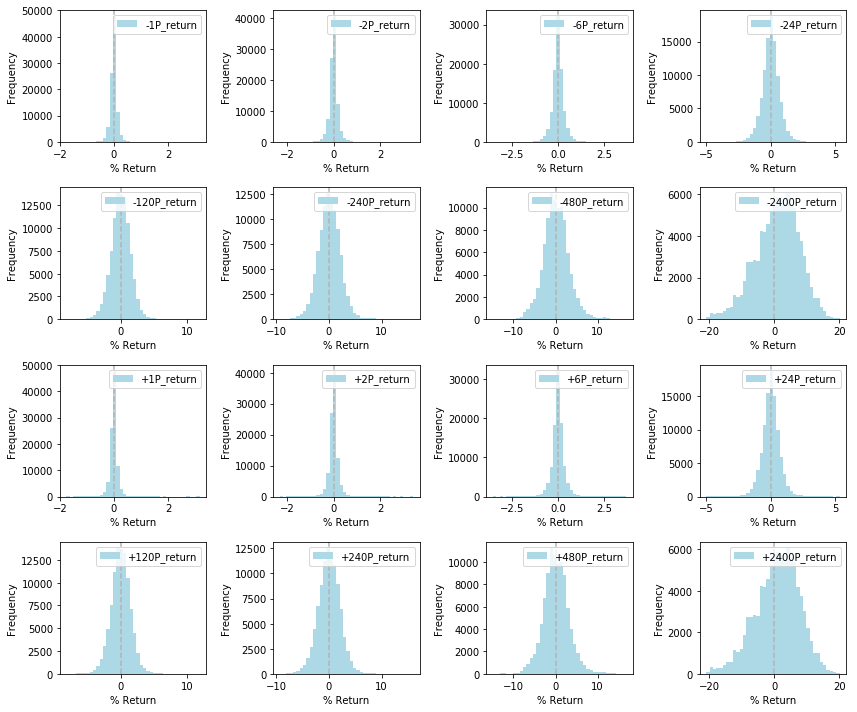

In [38]:
print('*'*10, "Test For t-distribution wit df=10", '*'*10)
fig = plt.figure(figsize=(12, 10))
for i, label in enumerate(return_labels):
    ax = fig.add_subplot(4, 4, i+1)
    series =  ta.data[label].dropna()
    _, pval = scs.kstest(np.array(series), 't', args=(10,))
    print('%12s:\t\tp-value = %f' % (label, pval))
    ax.axvline(0, ls='--', color='0.7')
    series.plot(kind='hist', bins=40, color='lightblue', ax=ax, label=label)
    ax.set_xlabel('% Return')
    ax.legend()
plt.tight_layout()

### Assessing auto-correlation by visualization

Here I'm assessing if there is any correlation between trailing and future returns. This is an informal test for auto-correlation, where whether the past performance for a given period is any predicitive of the future performance for a given period. Auto-correlation should be formally tested with autoregressive models (AR, etc)

Evaluate if trailing returns (returns up to a timepoint) correlate with future returns (return from a timepoint). The former is indicated with '-' sign and the latter with '+' in the DataFrame labels. In this notebook, 1, 2, and 6 hours, as well as 1, 5, 10, 20, and 100 day returns of both kinds were tracked. Trailing returns are scattered against future returns and Pearson's correlations were calculated.

CPU times: user 14 s, sys: 7.75 s, total: 21.8 s
Wall time: 11.1 s


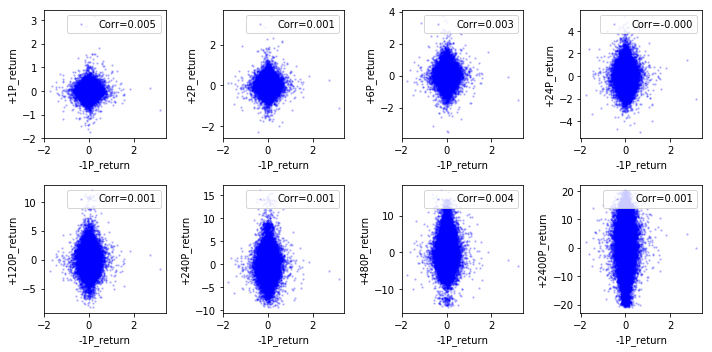

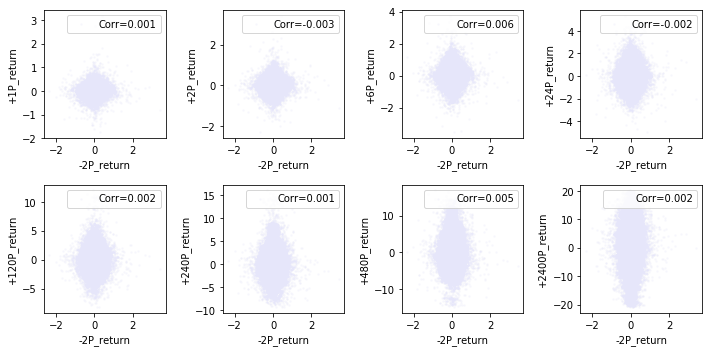

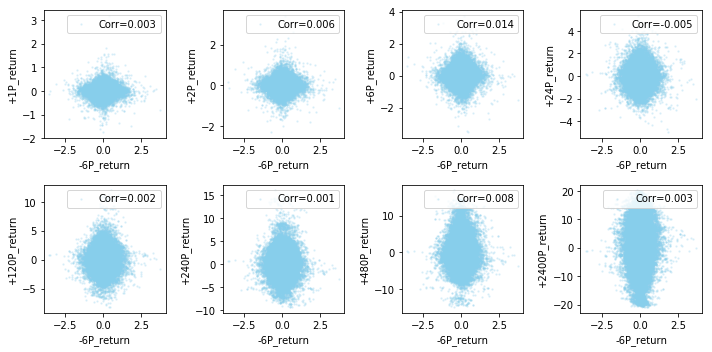

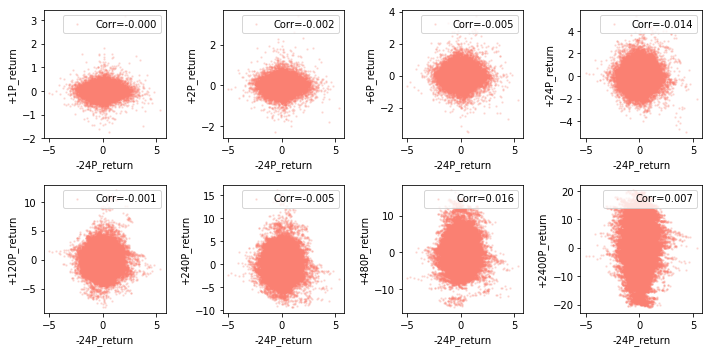

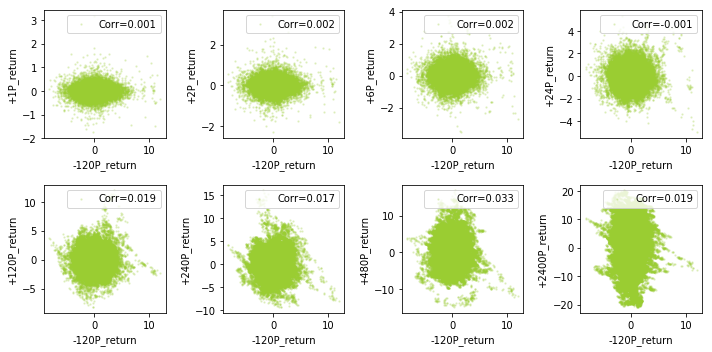

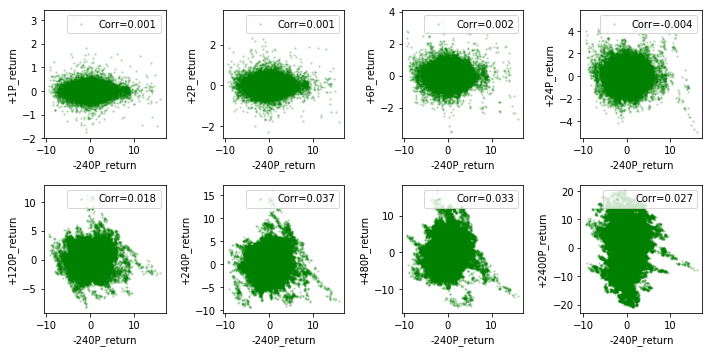

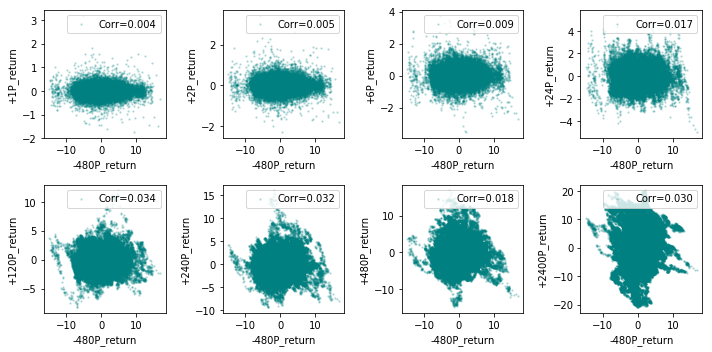

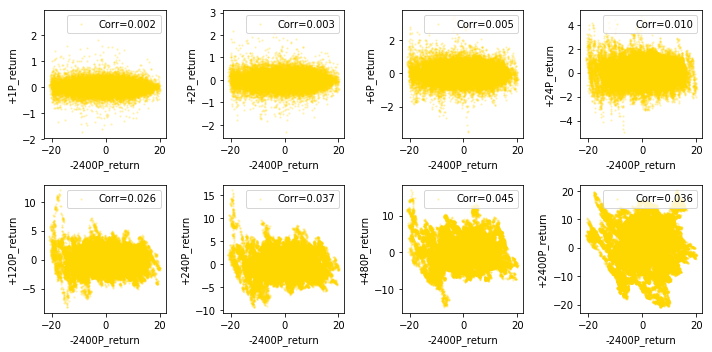

In [39]:
%%time
colors = ['blue', 'lavender', 'skyblue', 'salmon', 'yellowgreen', 'green', 'teal', 'gold']
for i, minus_r in enumerate(minus_labels):
    fig = plt.figure(figsize=(10, 5))
    for j, plus_r in enumerate(plus_labels):
        ax = fig.add_subplot(2, 4, j+1)
        pearson = ta.data[minus_r].corr(ta.data[plus_r])
        ax.scatter(ta.data[minus_r], ta.data[plus_r], color=colors[i], s=2, alpha=0.2, label=('Corr=%.3f' % pearson))
        ax.set_xlabel(minus_r)
        ax.set_ylabel(plus_r)
        ax.legend(loc='upper right')
    plt.tight_layout()

It appears that overall, trends do not persist. So trend up to a point does not correlate with trend from that point for both short and longer periods. 

In [40]:
%%time
### THIS ONE TAKES A LONG TIME TO COMPLETE SO RUN WHEN NECESSARY
if False:
    cmaps = ['Blues', 'Reds', 'Greens', 'Purples', 'Oranges', 'Greys', 'YlOrRd', 'PuBu']
    for i, minus_r in enumerate(minus_labels):
        print('%d-Processing %s...' % (i+1, minus_r))
        fig = plt.figure(figsize=(12, 6))
        for j, plus_r in enumerate(plus_labels):
            print('\t%dProcessing %s...' % (j+1, plus_r))
            ax = fig.add_subplot(2, 4, j+1)
            df = pd.concat([ta.data[minus_r], ta.data[plus_r]], axis=1).dropna()
            sns.kdeplot(df.iloc[:, 0], df.iloc[:, 1], bw='silverman', cmap=cmaps[i], ax=ax)
            ax.set_xlabel(minus_r)
            ax.set_ylabel(plus_r)
            pearson = ta.data[minus_r].corr(ta.data[plus_r])
            ax.set_title('Pearson\'s Correlation=%.3f' % pearson)
        plt.tight_layout()

CPU times: user 5 µs, sys: 3 µs, total: 8 µs
Wall time: 4.77 µs


There appears to be some substructures based on the kde plots, especially for longer term returns. It'd be interesting to see what conditions those different peaks in density correspond to.